# 1.&nbsp;**XMem: Long-Term Video Object Segmentation with an Atkinson-Shiffrin Memory Model**


![XMem Pipeline](https://camo.githubusercontent.com/8612d7bb02f1386fc936696cb572787650b31c28cb15be66123aec52e7af4f67/68747470733a2f2f696d6775722e636f6d2f546f45326672782e6a7067)


We frame Video Object Segmentation (VOS), first and foremost, as a memory problem. Prior works mostly use a single type of feature memory. This can be in the form of network weights (i.e., online learning), last frame segmentation (e.g., MaskTrack), spatial hidden representation (e.g., Conv-RNN-based methods), spatial-attentional features (e.g., STM, STCN, AOT), or some sort of long-term compact features (e.g., AFB-URR).

Methods with a short memory span are not robust to changes, while those with a large memory bank are subject to a catastrophic increase in computation and GPU memory usage. Attempts at long-term attentional VOS like AFB-URR compress features eagerly as soon as they are generated, leading to a loss of feature resolution.

Our method is inspired by the Atkinson-Shiffrin human memory model, which has a sensory memory, a working memory, and a long-term memory. These memory stores have different temporal scales and complement each other in our memory reading mechanism. It performs well in both short-term and long-term video datasets, handling videos with more than 10,000 frames with ease.

https://github.com/hkchengrex/XMem

In [1]:
!git clone https://github.com/hkchengrex/XMem.git

Cloning into 'XMem'...
remote: Enumerating objects: 596, done.
remote: Counting objects: 100% (323/323), done.
remote: Compressing objects: 100% (127/127), done.
remote: Total 596 (delta 233), reused 210 (delta 195), pack-reused 273
Receiving objects: 100% (596/596), 265.06 KiB | 3.12 MiB/s, done.
Resolving deltas: 100% (345/345), done.


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!nvidia-smi

import torch
from IPython.display import display
from IPython.display import  HTML
import torchvision

if torch.cuda.is_available():
  print('Using GPU')
  device = 'cuda'
else:
  print('CUDA not available. Please connect to a GPU instance if possible.')
  device = 'cpu'

Mon Dec  4 22:55:37 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   52C    P8    10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [4]:
!pip install opencv-python
!pip install -r /content/XMem/requirements.txt
!wget -P /content/ https://github.com/hkchengrex/XMem/releases/download/v1.0/XMem.pth



  Cloning https://github.com/cheind/py-thin-plate-spline to /tmp/pip-req-build-0qrnvmdn
  Running command git clone --filter=blob:none --quiet https://github.com/cheind/py-thin-plate-spline /tmp/pip-req-build-0qrnvmdn
  Resolved https://github.com/cheind/py-thin-plate-spline to commit f6995795397118b7d0ac01aecd3f39ffbfad9dee
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 107.9/107.9 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.1 MB/s eta 0:00:00
  Created wheel for thinplate: filename=thinplate-1.0.0-py3-none-any.whl size=6701 sha256=104f2507eb758ae68522ce9a7366943880cabd6af37d08aa56ae93748428b760
  Stored in directory: /tmp/pip-ephem-wheel-cache-iug6ak4p/wheels/3e/f3/84/5780510c4585ad00e08b99a8ae29904185f037823b777af27c
Successfully built thinplate
--2023-12-04 22:56:03--  https://github.com/hkchengrex/XMem/releases/download/

In [5]:
%cd XMem

/content/XMem


In [6]:
import os
from os import path
from argparse import ArgumentParser
import shutil

import torch
import torch.nn.functional as F
from torch.utils.data import DataLoader
import numpy as np
from PIL import Image

from inference.data.test_datasets import LongTestDataset, DAVISTestDataset, YouTubeVOSTestDataset
from inference.data.mask_mapper import MaskMapper
from model.network import XMem
from inference.inference_core import InferenceCore

from progressbar import progressbar

torch.set_grad_enabled(False)

# default configuration
config = {
    'top_k': 30,
    'mem_every': 5,
    'deep_update_every': -1,
    'enable_long_term': True,
    'enable_long_term_count_usage': True,
    'num_prototypes': 128,
    'min_mid_term_frames': 5,
    'max_mid_term_frames': 10,
    'max_long_term_elements': 10000,
}


network = XMem(config, '/content/XMem.pth').eval().to(device)


Hyperparameters read from the model weights: C^k=64, C^v=512, C^h=64
Single object mode: False


Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 186MB/s]
Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 80.2MB/s]


In [7]:
%cd /content/

/content


# 2.&nbsp;**Segment-Anything**


![Image Description](https://raw.githubusercontent.com/facebookresearch/segment-anything/main/assets/model_diagram.png)

The Segment Anything Model (SAM) produces high quality object masks from input prompts such as points or boxes, and it can be used to generate masks for all objects in an image. It has been trained on a dataset of 11 million images and 1.1 billion masks, and has strong zero-shot performance on a variety of segmentation tasks.

https://github.com/facebookresearch/segment-anything

In [8]:
!git clone https://github.com/facebookresearch/segment-anything.git
%cd segment-anything
!pip install -e .

Cloning into 'segment-anything'...
remote: Enumerating objects: 295, done.
remote: Total 295 (delta 0), reused 0 (delta 0), pack-reused 295
Receiving objects: 100% (295/295), 18.30 MiB | 24.66 MiB/s, done.
Resolving deltas: 100% (155/155), done.
/content/segment-anything
Obtaining file:///content/segment-anything
  Preparing metadata (setup.py) ... done
  Running setup.py develop for segment-anything


## 2.1.&nbsp;**Segment-Anything Implementation for Testing**

In this section, we will implement and test the "Segment-Anything" algorithm. This cutting-edge approach to image segmentation leverages advanced machine learning techniques to identify and segment various objects or features within an image, regardless of their type or complexity.

In [9]:
#implementing segment_anything

!pip install -q transformers
import numpy as np
import matplotlib.pyplot as plt

def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)


def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))

def show_boxes_on_image(raw_image, boxes):
    plt.figure(figsize=(10,10))
    plt.imshow(raw_image)
    for box in boxes:
      show_box(box, plt.gca())
    plt.axis('on')
    plt.show()

def show_points_on_image(raw_image, input_points, input_labels=None):
    plt.figure(figsize=(10,10))
    plt.imshow(raw_image)
    input_points = np.array(input_points)
    if input_labels is None:
      labels = np.ones_like(input_points[:, 0])
    else:
      labels = np.array(input_labels)
    show_points(input_points, labels, plt.gca())
    plt.axis('on')
    plt.show()

def show_points_and_boxes_on_image(raw_image, boxes, input_points, input_labels=None):
    plt.figure(figsize=(10,10))
    plt.imshow(raw_image)
    input_points = np.array(input_points)
    if input_labels is None:
      labels = np.ones_like(input_points[:, 0])
    else:
      labels = np.array(input_labels)
    show_points(input_points, labels, plt.gca())
    for box in boxes:
      show_box(box, plt.gca())
    plt.axis('on')
    plt.show()


def show_points_and_boxes_on_image(raw_image, boxes, input_points, input_labels=None):
    plt.figure(figsize=(10,10))
    plt.imshow(raw_image)
    input_points = np.array(input_points)
    if input_labels is None:
      labels = np.ones_like(input_points[:, 0])
    else:
      labels = np.array(input_labels)
    show_points(input_points, labels, plt.gca())
    for box in boxes:
      show_box(box, plt.gca())
    plt.axis('on')
    plt.show()


def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)


def show_masks_on_image(raw_image, masks, scores):
    if len(masks.shape) == 4:
      masks = masks.squeeze()
    if scores.shape[0] == 1:
      scores = scores.squeeze()

    nb_predictions = scores.shape[-1]
    fig, axes = plt.subplots(1, nb_predictions, figsize=(15, 15))

    for i, (mask, score) in enumerate(zip(masks, scores)):
      mask = mask.cpu().detach()
      axes[i].imshow(np.array(raw_image))
      show_mask(mask, axes[i])
      axes[i].title.set_text(f"Mask {i+1}, Score: {score.item():.3f}")
      axes[i].axis("off")
    plt.show()


In [10]:
import torch
from transformers import SamModel, SamProcessor

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = SamModel.from_pretrained("facebook/sam-vit-huge").to(device)
processor = SamProcessor.from_pretrained("facebook/sam-vit-huge")

config.json:   0%|          | 0.00/6.57k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/2.56G [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/466 [00:00<?, ?B/s]

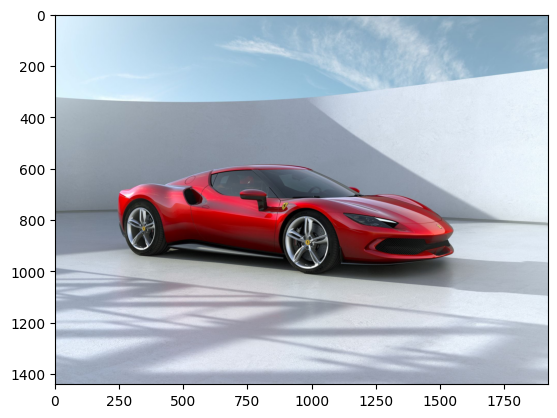

In [11]:
from PIL import Image
import requests

img_url = "https://www.reuters.com/resizer/nKNuP7CUMD-waJzzPrITsw0CMcY=/1920x0/filters:quality(80)/cloudfront-us-east-2.images.arcpublishing.com/reuters/UJULRTTCDFNBTEJAC4Y3SXIKW4.jpg"
raw_image = Image.open(requests.get(img_url, stream=True).raw).convert("RGB")

plt.imshow(raw_image)

In [12]:
inputs = processor(raw_image, return_tensors="pt").to(device)
image_embeddings = model.get_image_embeddings(inputs["pixel_values"])

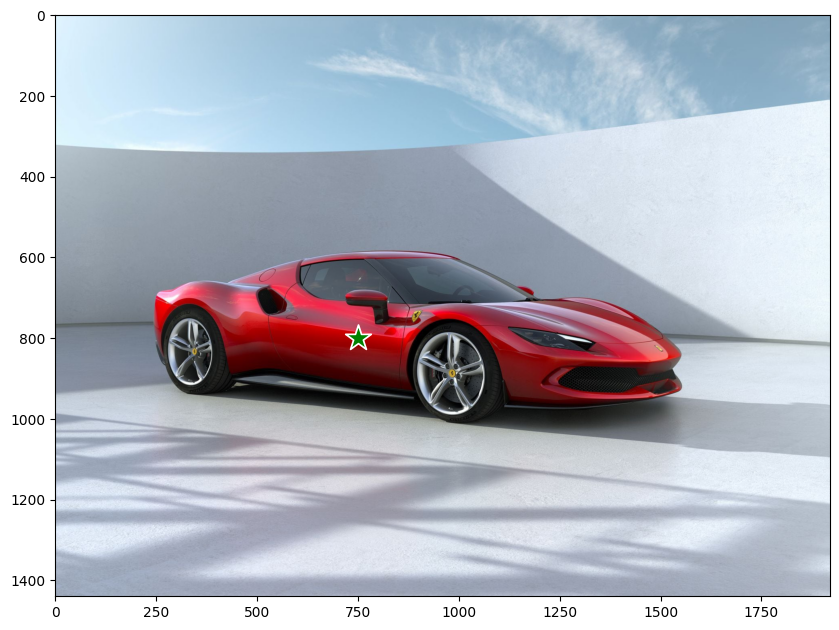

In [13]:
input_points = [[[750, 800]]]
show_points_on_image(raw_image, input_points[0])

In [14]:
inputs = processor(raw_image, input_points=input_points, return_tensors="pt").to(device)
# pop the pixel_values as they are not neded
inputs.pop("pixel_values", None)
inputs.update({"image_embeddings": image_embeddings})

with torch.no_grad():
    outputs = model(**inputs)

masks = processor.image_processor.post_process_masks(outputs.pred_masks.cpu(), inputs["original_sizes"].cpu(), inputs["reshaped_input_sizes"].cpu())
scores = outputs.iou_scores

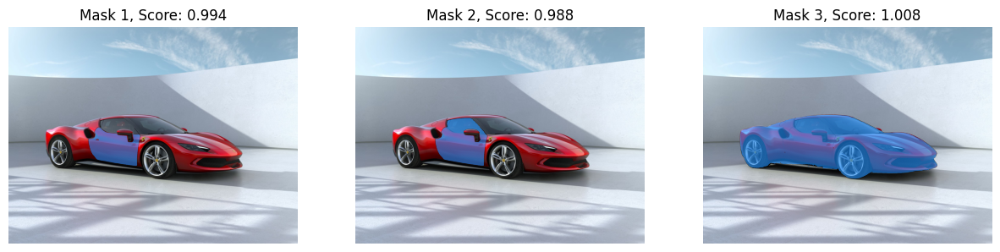

In [15]:
show_masks_on_image(raw_image, masks[0], scores)

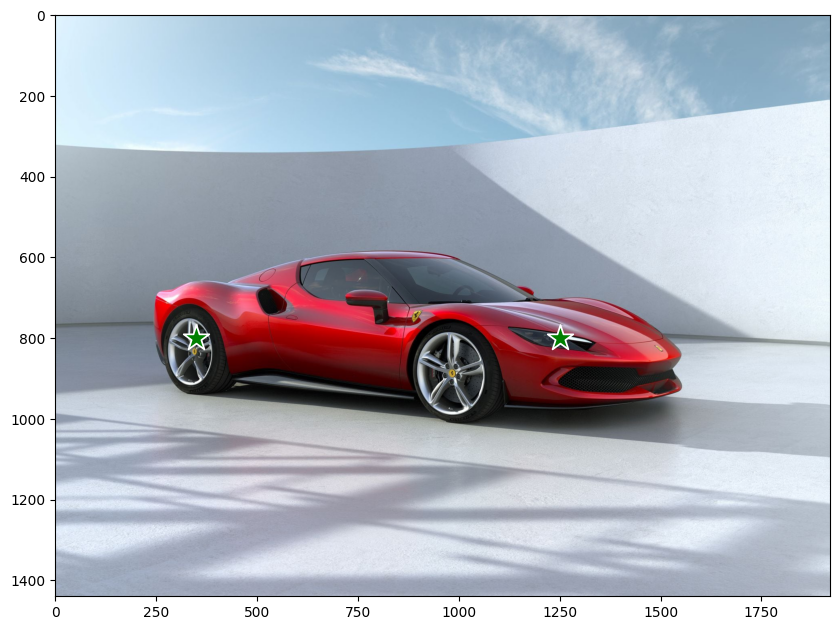

In [16]:
input_points = [[[350, 800], [1250, 800]]]
show_points_on_image(raw_image, input_points)

In [17]:
inputs = processor(raw_image, input_points=input_points, return_tensors="pt").to(device)
# pop the pixel_values as they are not neded
inputs.pop("pixel_values", None)
inputs.update({"image_embeddings": image_embeddings})

with torch.no_grad():
    outputs = model(**inputs)

masks = processor.image_processor.post_process_masks(outputs.pred_masks.cpu(), inputs["original_sizes"].cpu(), inputs["reshaped_input_sizes"].cpu())
scores = outputs.iou_scores

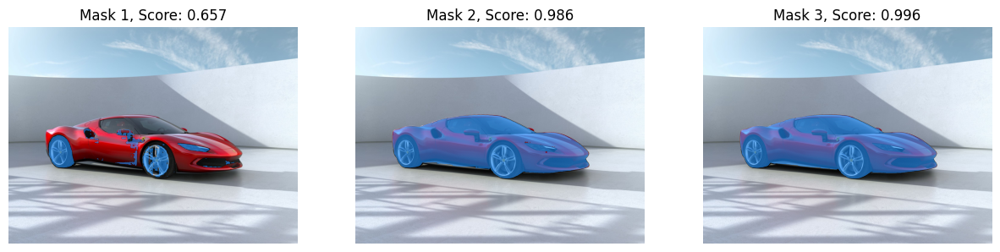

In [18]:
show_masks_on_image(raw_image, masks[0], scores)

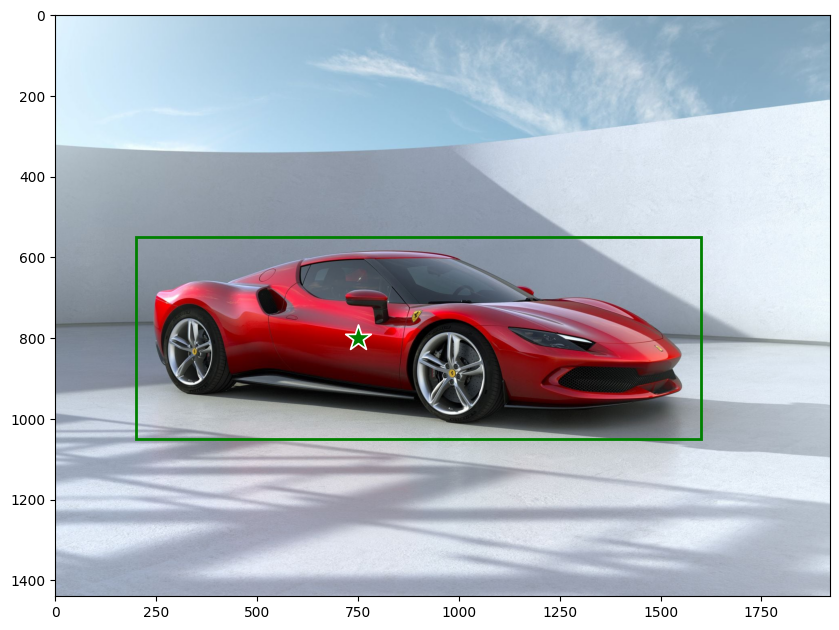

In [19]:
input_boxes = [[[200, 550, 1600, 1050]]]
input_points = [[[750, 800]]]

show_points_and_boxes_on_image(raw_image, input_boxes[0], input_points[0])

In [20]:
inputs = processor(raw_image, input_boxes=[input_boxes], input_points=[input_points], return_tensors="pt").to(device)

inputs.pop("pixel_values", None)
inputs.update({"image_embeddings": image_embeddings})

with torch.no_grad():
    outputs = model(**inputs)

masks = processor.image_processor.post_process_masks(outputs.pred_masks.cpu(), inputs["original_sizes"].cpu(), inputs["reshaped_input_sizes"].cpu())
scores = outputs.iou_scores

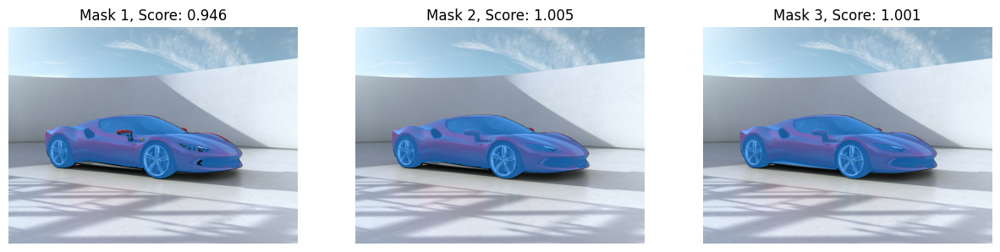

In [21]:
show_masks_on_image(raw_image, masks[0][0], scores[:, 0, :])

## 2.2.&nbsp;**Segment-Anything Implementation on test_video.avi**

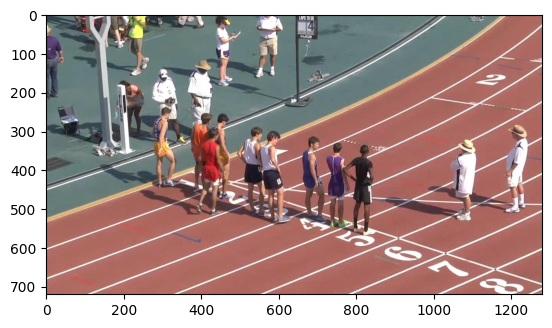

In [22]:
#implementing SAM on the first frame of our input image
from PIL import Image
import matplotlib.pyplot as plt

# Load and display the image from the specified directory
image_path = '/content/drive/MyDrive/img/00000002.jpg'
image = Image.open(image_path)

# Display the image
plt.imshow(image)
plt.axis('on')  # Turn on axis numbers
plt.show()


## 2.2.1&nbsp;**Segment-Anything (Feed a set of 2D points to predict a mask)**

In this section of the Colab notebook, we'll explore the process of image masking using custom 2D points in Python. We'll start by loading an image and then define a set of 2D points which will serve as the vertices of our mask. This mask will then be applied to the image to either highlight or hide specific regions, depending on the mask shape and the points defined.

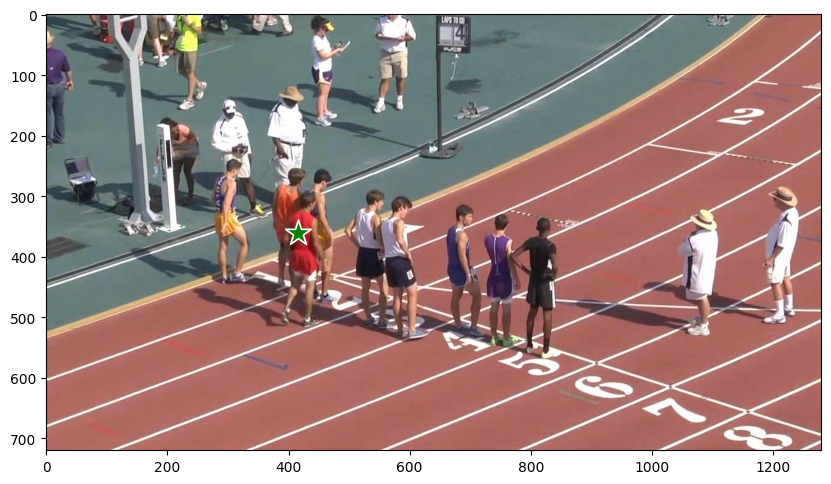

In [23]:
#input_boxes = [[[380, 520, 470, 280]]]
input_points = [[[415, 360]]]

#input_points = [[[750, 800]]]
show_points_on_image(image, input_points[0])

#show_points_and_boxes_on_image(image, input_boxes[0], input_points[0])

In [24]:


from IPython.display import display, HTML
display(HTML(
"""
<a target="_blank" href="https://colab.research.google.com/github/facebookresearch/segment-anything/blob/main/notebooks/predictor_example.ipynb">
  <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>
"""
))



In [25]:


    import sys
    !{sys.executable} -m pip install opencv-python matplotlib
    !{sys.executable} -m pip install 'git+https://github.com/facebookresearch/segment-anything.git'

    !mkdir images
    !wget -P images https://raw.githubusercontent.com/facebookresearch/segment-anything/main/notebooks/images/truck.jpg
    !wget -P images https://raw.githubusercontent.com/facebookresearch/segment-anything/main/notebooks/images/groceries.jpg

    !wget https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth

  Cloning https://github.com/facebookresearch/segment-anything.git to /tmp/pip-req-build-qra49uy2
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/segment-anything.git /tmp/pip-req-build-qra49uy2
  Resolved https://github.com/facebookresearch/segment-anything.git to commit 6fdee8f2727f4506cfbbe553e23b895e27956588
  Preparing metadata (setup.py) ... done
  Created wheel for segment-anything: filename=segment_anything-1.0-py3-none-any.whl size=36587 sha256=c63a85105cb002fbe494d23abb6caf7e7c9fb94df1bcff056f2424134ab44fd0
  Stored in directory: /tmp/pip-ephem-wheel-cache-b91nxn7m/wheels/10/cf/59/9ccb2f0a1bcc81d4fbd0e501680b5d088d690c6cfbc02dc99d
Successfully built segment-anything
  Attempting uninstall: segment-anything
    Found existing installation: segment-anything 1.0
    Uninstalling segment-anything-1.0:
      Successfully uninstalled segment-anything-1.0
--2023-12-04 23:00:29--  https://raw.githubusercontent.com/facebookresearch/segment-an

## 2.2.2&nbsp;**Initializing Specific Classes and Functions from Segment-Anything**

In [26]:
# Copyright (c) Meta Platforms, Inc. and affiliates.
# All rights reserved.

# This source code is licensed under the license found in the
# LICENSE file in the root directory of this source tree.

import numpy as np
import torch
from torch.nn import functional as F
from torchvision.transforms.functional import resize, to_pil_image  # type: ignore

from copy import deepcopy
from typing import Tuple


class ResizeLongestSide:
    """
    Resizes images to the longest side 'target_length', as well as provides
    methods for resizing coordinates and boxes. Provides methods for
    transforming both numpy array and batched torch tensors.
    """

    def __init__(self, target_length: int) -> None:
        self.target_length = target_length

    def apply_image(self, image: np.ndarray) -> np.ndarray:
        """
        Expects a numpy array with shape HxWxC in uint8 format.
        """
        target_size = self.get_preprocess_shape(image.shape[0], image.shape[1], self.target_length)
        return np.array(resize(to_pil_image(image), target_size))

    def apply_coords(self, coords: np.ndarray, original_size: Tuple[int, ...]) -> np.ndarray:
        """
        Expects a numpy array of length 2 in the final dimension. Requires the
        original image size in (H, W) format.
        """
        old_h, old_w = original_size
        new_h, new_w = self.get_preprocess_shape(
            original_size[0], original_size[1], self.target_length
        )
        coords = deepcopy(coords).astype(float)
        coords[..., 0] = coords[..., 0] * (new_w / old_w)
        coords[..., 1] = coords[..., 1] * (new_h / old_h)
        return coords

    def apply_boxes(self, boxes: np.ndarray, original_size: Tuple[int, ...]) -> np.ndarray:
        """
        Expects a numpy array shape Bx4. Requires the original image size
        in (H, W) format.
        """
        boxes = self.apply_coords(boxes.reshape(-1, 2, 2), original_size)
        return boxes.reshape(-1, 4)

    def apply_image_torch(self, image: torch.Tensor) -> torch.Tensor:
        """
        Expects batched images with shape BxCxHxW and float format. This
        transformation may not exactly match apply_image. apply_image is
        the transformation expected by the model.
        """
        # Expects an image in BCHW format. May not exactly match apply_image.
        target_size = self.get_preprocess_shape(image.shape[2], image.shape[3], self.target_length)
        return F.interpolate(
            image, target_size, mode="bilinear", align_corners=False, antialias=True
        )

    def apply_coords_torch(
        self, coords: torch.Tensor, original_size: Tuple[int, ...]
    ) -> torch.Tensor:
        """
        Expects a torch tensor with length 2 in the last dimension. Requires the
        original image size in (H, W) format.
        """
        old_h, old_w = original_size
        new_h, new_w = self.get_preprocess_shape(
            original_size[0], original_size[1], self.target_length
        )
        coords = deepcopy(coords).to(torch.float)
        coords[..., 0] = coords[..., 0] * (new_w / old_w)
        coords[..., 1] = coords[..., 1] * (new_h / old_h)
        return coords

    def apply_boxes_torch(
        self, boxes: torch.Tensor, original_size: Tuple[int, ...]
    ) -> torch.Tensor:
        """
        Expects a torch tensor with shape Bx4. Requires the original image
        size in (H, W) format.
        """
        boxes = self.apply_coords_torch(boxes.reshape(-1, 2, 2), original_size)
        return boxes.reshape(-1, 4)

    @staticmethod
    def get_preprocess_shape(oldh: int, oldw: int, long_side_length: int) -> Tuple[int, int]:
        """
        Compute the output size given input size and target long side length.
        """
        scale = long_side_length * 1.0 / max(oldh, oldw)
        newh, neww = oldh * scale, oldw * scale
        neww = int(neww + 0.5)
        newh = int(newh + 0.5)
        return (newh, neww)


In [27]:
# Copyright (c) Meta Platforms, Inc. and affiliates.
# All rights reserved.

# This source code is licensed under the license found in the
# LICENSE file in the root directory of this source tree.

import numpy as np
import torch

from segment_anything.modeling import Sam

from typing import Optional, Tuple

#from .utils.transforms import ResizeLongestSide


class SamPredictor:
    def __init__(
        self,
        sam_model: Sam,
    ) -> None:
        """
        Uses SAM to calculate the image embedding for an image, and then
        allow repeated, efficient mask prediction given prompts.

        Arguments:
          sam_model (Sam): The model to use for mask prediction.
        """
        super().__init__()
        self.model = sam_model
        self.transform = ResizeLongestSide(sam_model.image_encoder.img_size)
        self.reset_image()

    def set_image(
        self,
        image: np.ndarray,
        image_format: str = "RGB",
    ) -> None:
        """
        Calculates the image embeddings for the provided image, allowing
        masks to be predicted with the 'predict' method.

        Arguments:
          image (np.ndarray): The image for calculating masks. Expects an
            image in HWC uint8 format, with pixel values in [0, 255].
          image_format (str): The color format of the image, in ['RGB', 'BGR'].
        """
        assert image_format in [
            "RGB",
            "BGR",
        ], f"image_format must be in ['RGB', 'BGR'], is {image_format}."
        if image_format != self.model.image_format:
            image = image[..., ::-1]

        # Transform the image to the form expected by the model
        input_image = self.transform.apply_image(image)
        input_image_torch = torch.as_tensor(input_image, device=self.device)
        input_image_torch = input_image_torch.permute(2, 0, 1).contiguous()[None, :, :, :]

        self.set_torch_image(input_image_torch, image.shape[:2])

    @torch.no_grad()
    def set_torch_image(
        self,
        transformed_image: torch.Tensor,
        original_image_size: Tuple[int, ...],
    ) -> None:
        """
        Calculates the image embeddings for the provided image, allowing
        masks to be predicted with the 'predict' method. Expects the input
        image to be already transformed to the format expected by the model.

        Arguments:
          transformed_image (torch.Tensor): The input image, with shape
            1x3xHxW, which has been transformed with ResizeLongestSide.
          original_image_size (tuple(int, int)): The size of the image
            before transformation, in (H, W) format.
        """
        assert (
            len(transformed_image.shape) == 4
            and transformed_image.shape[1] == 3
            and max(*transformed_image.shape[2:]) == self.model.image_encoder.img_size
        ), f"set_torch_image input must be BCHW with long side {self.model.image_encoder.img_size}."
        self.reset_image()

        self.original_size = original_image_size
        self.input_size = tuple(transformed_image.shape[-2:])
        input_image = self.model.preprocess(transformed_image)
        self.features = self.model.image_encoder(input_image)
        self.is_image_set = True

    def predict(
        self,
        point_coords: Optional[np.ndarray] = None,
        point_labels: Optional[np.ndarray] = None,
        box: Optional[np.ndarray] = None,
        mask_input: Optional[np.ndarray] = None,
        multimask_output: bool = True,
        return_logits: bool = False,
    ) -> Tuple[np.ndarray, np.ndarray, np.ndarray]:
        """
        Predict masks for the given input prompts, using the currently set image.

        Arguments:
          point_coords (np.ndarray or None): A Nx2 array of point prompts to the
            model. Each point is in (X,Y) in pixels.
          point_labels (np.ndarray or None): A length N array of labels for the
            point prompts. 1 indicates a foreground point and 0 indicates a
            background point.
          box (np.ndarray or None): A length 4 array given a box prompt to the
            model, in XYXY format.
          mask_input (np.ndarray): A low resolution mask input to the model, typically
            coming from a previous prediction iteration. Has form 1xHxW, where
            for SAM, H=W=256.
          multimask_output (bool): If true, the model will return three masks.
            For ambiguous input prompts (such as a single click), this will often
            produce better masks than a single prediction. If only a single
            mask is needed, the model's predicted quality score can be used
            to select the best mask. For non-ambiguous prompts, such as multiple
            input prompts, multimask_output=False can give better results.
          return_logits (bool): If true, returns un-thresholded masks logits
            instead of a binary mask.

        Returns:
          (np.ndarray): The output masks in CxHxW format, where C is the
            number of masks, and (H, W) is the original image size.
          (np.ndarray): An array of length C containing the model's
            predictions for the quality of each mask.
          (np.ndarray): An array of shape CxHxW, where C is the number
            of masks and H=W=256. These low resolution logits can be passed to
            a subsequent iteration as mask input.
        """
        if not self.is_image_set:
            raise RuntimeError("An image must be set with .set_image(...) before mask prediction.")

        # Transform input prompts
        coords_torch, labels_torch, box_torch, mask_input_torch = None, None, None, None
        if point_coords is not None:
            assert (
                point_labels is not None
            ), "point_labels must be supplied if point_coords is supplied."
            point_coords = self.transform.apply_coords(point_coords, self.original_size)
            coords_torch = torch.as_tensor(point_coords, dtype=torch.float, device=self.device)
            labels_torch = torch.as_tensor(point_labels, dtype=torch.int, device=self.device)
            coords_torch, labels_torch = coords_torch[None, :, :], labels_torch[None, :]
        if box is not None:
            box = self.transform.apply_boxes(box, self.original_size)
            box_torch = torch.as_tensor(box, dtype=torch.float, device=self.device)
            box_torch = box_torch[None, :]
        if mask_input is not None:
            mask_input_torch = torch.as_tensor(mask_input, dtype=torch.float, device=self.device)
            mask_input_torch = mask_input_torch[None, :, :, :]

        masks, iou_predictions, low_res_masks = self.predict_torch(
            coords_torch,
            labels_torch,
            box_torch,
            mask_input_torch,
            multimask_output,
            return_logits=return_logits,
        )

        masks_np = masks[0].detach().cpu().numpy()
        iou_predictions_np = iou_predictions[0].detach().cpu().numpy()
        low_res_masks_np = low_res_masks[0].detach().cpu().numpy()
        return masks_np, iou_predictions_np, low_res_masks_np

    @torch.no_grad()
    def predict_torch(
        self,
        point_coords: Optional[torch.Tensor],
        point_labels: Optional[torch.Tensor],
        boxes: Optional[torch.Tensor] = None,
        mask_input: Optional[torch.Tensor] = None,
        multimask_output: bool = True,
        return_logits: bool = False,
    ) -> Tuple[torch.Tensor, torch.Tensor, torch.Tensor]:
        """
        Predict masks for the given input prompts, using the currently set image.
        Input prompts are batched torch tensors and are expected to already be
        transformed to the input frame using ResizeLongestSide.

        Arguments:
          point_coords (torch.Tensor or None): A BxNx2 array of point prompts to the
            model. Each point is in (X,Y) in pixels.
          point_labels (torch.Tensor or None): A BxN array of labels for the
            point prompts. 1 indicates a foreground point and 0 indicates a
            background point.
          boxes (np.ndarray or None): A Bx4 array given a box prompt to the
            model, in XYXY format.
          mask_input (np.ndarray): A low resolution mask input to the model, typically
            coming from a previous prediction iteration. Has form Bx1xHxW, where
            for SAM, H=W=256. Masks returned by a previous iteration of the
            predict method do not need further transformation.
          multimask_output (bool): If true, the model will return three masks.
            For ambiguous input prompts (such as a single click), this will often
            produce better masks than a single prediction. If only a single
            mask is needed, the model's predicted quality score can be used
            to select the best mask. For non-ambiguous prompts, such as multiple
            input prompts, multimask_output=False can give better results.
          return_logits (bool): If true, returns un-thresholded masks logits
            instead of a binary mask.

        Returns:
          (torch.Tensor): The output masks in BxCxHxW format, where C is the
            number of masks, and (H, W) is the original image size.
          (torch.Tensor): An array of shape BxC containing the model's
            predictions for the quality of each mask.
          (torch.Tensor): An array of shape BxCxHxW, where C is the number
            of masks and H=W=256. These low res logits can be passed to
            a subsequent iteration as mask input.
        """
        if not self.is_image_set:
            raise RuntimeError("An image must be set with .set_image(...) before mask prediction.")

        if point_coords is not None:
            points = (point_coords, point_labels)
        else:
            points = None

        # Embed prompts
        sparse_embeddings, dense_embeddings = self.model.prompt_encoder(
            points=points,
            boxes=boxes,
            masks=mask_input,
        )

        # Predict masks
        low_res_masks, iou_predictions = self.model.mask_decoder(
            image_embeddings=self.features,
            image_pe=self.model.prompt_encoder.get_dense_pe(),
            sparse_prompt_embeddings=sparse_embeddings,
            dense_prompt_embeddings=dense_embeddings,
            multimask_output=multimask_output,
        )

        # Upscale the masks to the original image resolution
        masks = self.model.postprocess_masks(low_res_masks, self.input_size, self.original_size)

        if not return_logits:
            masks = masks > self.model.mask_threshold

        return masks, iou_predictions, low_res_masks

    def get_image_embedding(self) -> torch.Tensor:
        """
        Returns the image embeddings for the currently set image, with
        shape 1xCxHxW, where C is the embedding dimension and (H,W) are
        the embedding spatial dimension of SAM (typically C=256, H=W=64).
        """
        if not self.is_image_set:
            raise RuntimeError(
                "An image must be set with .set_image(...) to generate an embedding."
            )
        assert self.features is not None, "Features must exist if an image has been set."
        return self.features

    @property
    def device(self) -> torch.device:
        return self.model.device

    def reset_image(self) -> None:
        """Resets the currently set image."""
        self.is_image_set = False
        self.features = None
        self.orig_h = None
        self.orig_w = None
        self.input_h = None
        self.input_w = None


In [28]:
import cv2
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size, edgecolor='white', linewidth=1.25)

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0), lw=2))

In [29]:
import sys
sys.path.append("..")
from segment_anything import sam_model_registry, SamPredictor

sam_checkpoint = "sam_vit_h_4b8939.pth"
model_type = "vit_h"

device = "cuda"

sam = sam_model_registry[model_type](checkpoint=sam_checkpoint)
sam.to(device=device)

predictor = SamPredictor(sam)

In [30]:
image = cv2.imread('/content/drive/MyDrive/img/00000002.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

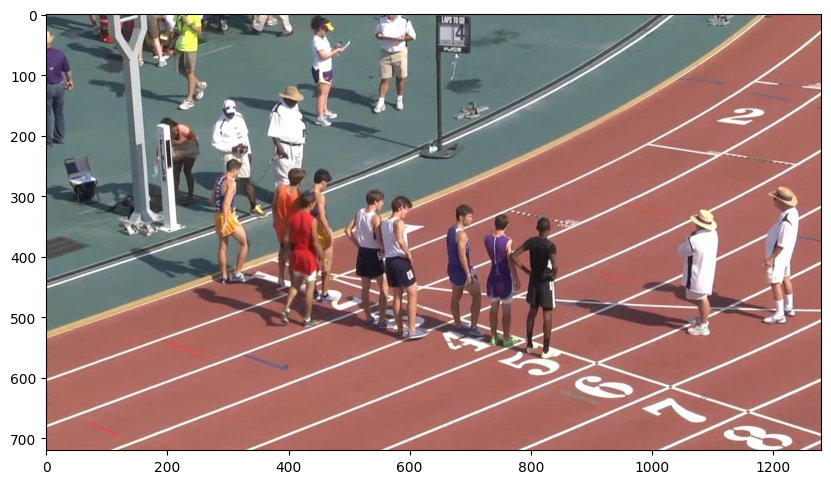

In [31]:
plt.figure(figsize=(10,10))
plt.imshow(image)
plt.axis('on')
plt.show()

In [32]:
predictor.set_image(image)

In [33]:
input_point = np.array([[415, 360]])
input_label = np.array([1])

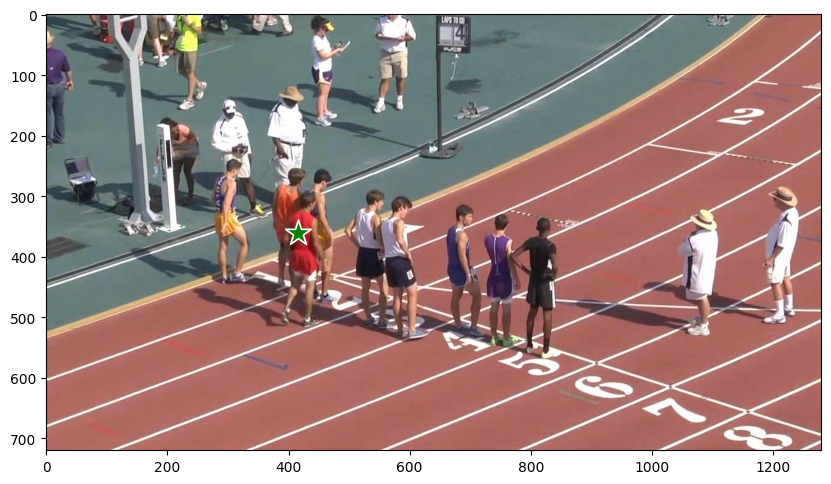

In [34]:
plt.figure(figsize=(10,10))
plt.imshow(image)
show_points(input_point, input_label, plt.gca())
plt.axis('on')
plt.show()

In [35]:
masks, scores, logits = predictor.predict(
    point_coords=input_point,
    point_labels=input_label,
    multimask_output=True,
)

In [36]:
masks.shape

(3, 720, 1280)

## &nbsp;**Sucessful Mask Creation**

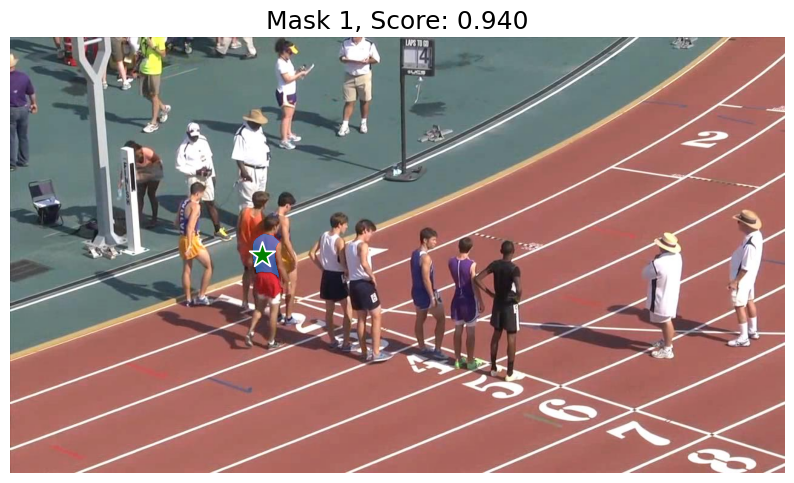

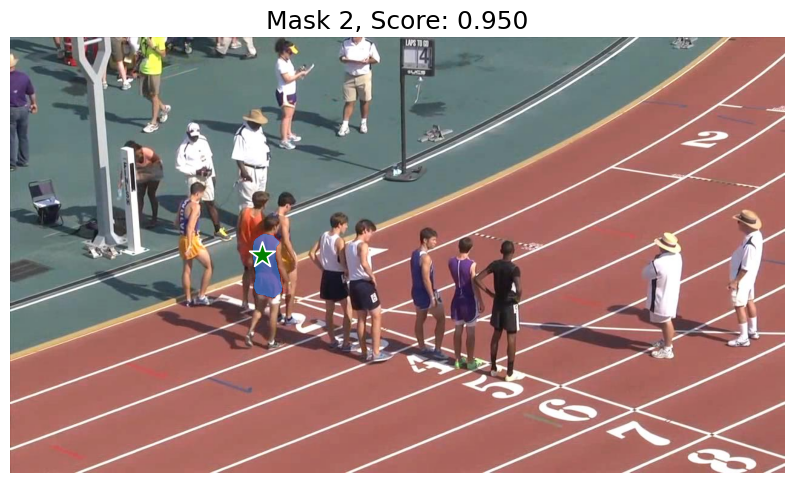

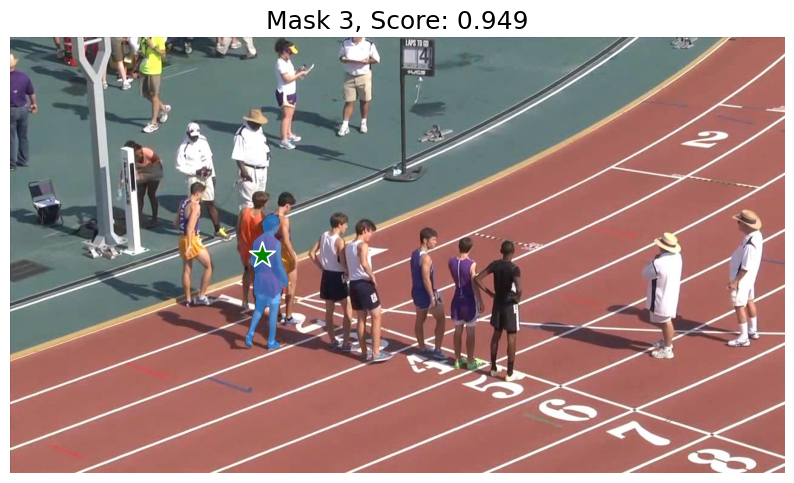

In [37]:
for i, (mask, score) in enumerate(zip(masks, scores)):
    plt.figure(figsize=(10,10))
    plt.imshow(image)
    show_mask(mask, plt.gca())
    show_points(input_point, input_label, plt.gca())
    plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
    plt.axis('off')
    plt.show() #using a single point to detect in this case works nice and well

## &nbsp;**Display the Mask in the given image**

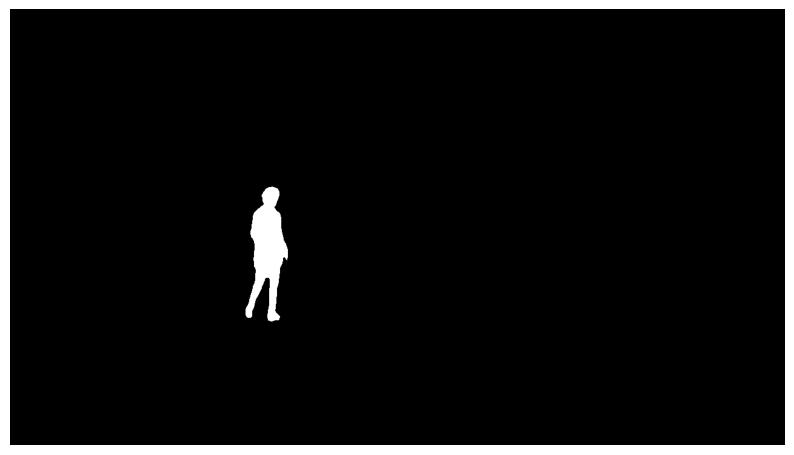

Mask Data:
 [[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]


In [38]:
import matplotlib.pyplot as plt
import numpy as np

def display_mask(mask_data):
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(mask_data, cmap='gray')  # Display the mask in grayscale
    ax.set_axis_off()  # Hide the axis
    plt.show()

#'masks' is a predefined list or array of mask data
selected_mask = masks[2]

# Call the function to display the selected mask
display_mask(selected_mask)

# Print the mask data
print("Mask Data:\n", np.array_str(selected_mask))


## &nbsp;**Building and defining XMem functions**

In [39]:
# Modifed from https://github.com/seoungwugoh/ivs-demo

import numpy as np

import torch
import torch.nn.functional as F
from util.palette import davis_palette
from dataset.range_transform import im_normalization

def image_to_torch(frame: np.ndarray, device='cuda'):
    # frame: H*W*3 numpy array
    frame = frame.transpose(2, 0, 1)
    frame = torch.from_numpy(frame).float().to(device)/255
    frame_norm = im_normalization(frame)
    return frame_norm, frame

def torch_prob_to_numpy_mask(prob):
    mask = torch.max(prob, dim=0).indices
    mask = mask.cpu().numpy().astype(np.uint8)
    return mask

def index_numpy_to_one_hot_torch(mask, num_classes):
    mask = torch.from_numpy(mask).long()
    return F.one_hot(mask, num_classes=num_classes).permute(2, 0, 1).float()

"""
Some constants fro visualization
"""
try:
    if torch.cuda.is_available():
        device = torch.device("cuda")
    elif torch.backends.mps.is_available():
        device = torch.device("mps")
    else:
        device = torch.device("cpu")
except:
    device = torch.device("cpu")

color_map_np = np.frombuffer(davis_palette, dtype=np.uint8).reshape(-1, 3).copy()
# scales for better visualization
color_map_np = (color_map_np.astype(np.float32)*1.5).clip(0, 255).astype(np.uint8)
color_map = color_map_np.tolist()
color_map_torch = torch.from_numpy(color_map_np).to(device) / 255

grayscale_weights = np.array([[0.3,0.59,0.11]]).astype(np.float32)
grayscale_weights_torch = torch.from_numpy(grayscale_weights).to(device).unsqueeze(0)

def get_visualization(mode, image, mask, layer, target_object):
    if mode == 'fade':
        return overlay_davis(image, mask, fade=True)
    elif mode == 'davis':
        return overlay_davis(image, mask)
    elif mode == 'light':
        return overlay_davis(image, mask, 0.9)
    elif mode == 'popup':
        return overlay_popup(image, mask, target_object)
    elif mode == 'layered':
        if layer is None:
            print('Layer file not given. Defaulting to DAVIS.')
            return overlay_davis(image, mask)
        else:
            return overlay_layer(image, mask, layer, target_object)
    else:
        raise NotImplementedError

def get_visualization_torch(mode, image, prob, layer, target_object):
    if mode == 'fade':
        return overlay_davis_torch(image, prob, fade=True)
    elif mode == 'davis':
        return overlay_davis_torch(image, prob)
    elif mode == 'light':
        return overlay_davis_torch(image, prob, 0.9)
    elif mode == 'popup':
        return overlay_popup_torch(image, prob, target_object)
    elif mode == 'layered':
        if layer is None:
            print('Layer file not given. Defaulting to DAVIS.')
            return overlay_davis_torch(image, prob)
        else:
            return overlay_layer_torch(image, prob, layer, target_object)
    else:
        raise NotImplementedError

def overlay_davis(image, mask, alpha=0.5, fade=False):
    """ Overlay segmentation on top of RGB image. from davis official"""
    im_overlay = image.copy()

    colored_mask = color_map_np[mask]
    foreground = image*alpha + (1-alpha)*colored_mask
    binary_mask = (mask > 0)
    # Compose image
    im_overlay[binary_mask] = foreground[binary_mask]
    if fade:
        im_overlay[~binary_mask] = im_overlay[~binary_mask] * 0.6
    return im_overlay.astype(image.dtype)

def overlay_popup(image, mask, target_object):
    # Keep foreground colored. Convert background to grayscale.
    im_overlay = image.copy()

    binary_mask = ~(np.isin(mask, target_object))
    colored_region = (im_overlay[binary_mask]*grayscale_weights).sum(-1, keepdims=-1)
    im_overlay[binary_mask] = colored_region
    return im_overlay.astype(image.dtype)

def overlay_layer(image, mask, layer, target_object):
    # insert a layer between foreground and background
    # The CPU version is less accurate because we are using the hard mask
    # The GPU version has softer edges as it uses soft probabilities
    obj_mask = (np.isin(mask, target_object)).astype(np.float32)[:, :, np.newaxis]
    layer_alpha = layer[:, :, 3].astype(np.float32)[:, :, np.newaxis] / 255
    layer_rgb = layer[:, :, :3]
    background_alpha = np.maximum(obj_mask, layer_alpha)
    im_overlay = (image * (1 - background_alpha) + layer_rgb * (1 - obj_mask) * layer_alpha +
                  image * obj_mask).clip(0, 255)
    return im_overlay.astype(image.dtype)

def overlay_davis_torch(image, mask, alpha=0.5, fade=False):
    """ Overlay segmentation on top of RGB image. from davis official"""
    # Changes the image in-place to avoid copying
    image = image.permute(1, 2, 0)
    im_overlay = image
    mask = torch.max(mask, dim=0).indices

    colored_mask = color_map_torch[mask]
    foreground = image*alpha + (1-alpha)*colored_mask
    binary_mask = (mask > 0)
    # Compose image
    im_overlay[binary_mask] = foreground[binary_mask]
    if fade:
        im_overlay[~binary_mask] = im_overlay[~binary_mask] * 0.6

    im_overlay = (im_overlay*255).cpu().numpy()
    im_overlay = im_overlay.astype(np.uint8)

    return im_overlay

def overlay_popup_torch(image, mask, target_object):
    # Keep foreground colored. Convert background to grayscale.
    image = image.permute(1, 2, 0)

    if len(target_object) == 0:
        obj_mask = torch.zeros_like(mask[0]).unsqueeze(2)
    else:
        obj_mask = mask[np.array(target_object,dtype=np.int32)].sum(0).unsqueeze(2)
    gray_image = (image*grayscale_weights_torch).sum(-1, keepdim=True)
    im_overlay = obj_mask*image + (1-obj_mask)*gray_image

    im_overlay = (im_overlay*255).cpu().numpy()
    im_overlay = im_overlay.astype(np.uint8)

    return im_overlay

def overlay_layer_torch(image, prob, layer, target_object):
    # insert a layer between foreground and background
    # The CPU version is less accurate because we are using the hard mask
    # The GPU version has softer edges as it uses soft probabilities
    image = image.permute(1, 2, 0)

    if len(target_object) == 0:
        obj_mask = torch.zeros_like(prob[0]).unsqueeze(2)
    else:
        obj_mask = prob[np.array(target_object, dtype=np.int32)].sum(0).unsqueeze(2)
    layer_alpha = layer[:, :, 3].unsqueeze(2)
    layer_rgb = layer[:, :, :3]
    background_alpha = torch.maximum(obj_mask, layer_alpha)
    im_overlay = (image * (1 - background_alpha) + layer_rgb * (1 - obj_mask) * layer_alpha +
                  image * obj_mask).clip(0, 1)

    im_overlay = (im_overlay * 255).cpu().numpy()
    im_overlay = im_overlay.astype(np.uint8)

    return im_overlay



In [40]:
from tensorflow.keras.layers import ConvLSTM2D


In [41]:
from inference.memory_manager import MemoryManager
from model.network import XMem
from model.aggregate import aggregate

from util.tensor_util import pad_divide_by, unpad


class InferenceCore:
    def __init__(self, network:XMem, config):
        self.config = config
        self.network = network
        self.mem_every = config['mem_every']
        self.deep_update_every = config['deep_update_every']
        self.enable_long_term = config['enable_long_term']

        # if deep_update_every < 0, synchronize deep update with memory frame
        self.deep_update_sync = (self.deep_update_every < 0)

        self.clear_memory()
        self.all_labels = None

    def clear_memory(self):
        self.curr_ti = -1
        self.last_mem_ti = 0
        if not self.deep_update_sync:
            self.last_deep_update_ti = -self.deep_update_every
        self.memory = MemoryManager(config=self.config)

    def update_config(self, config):
        self.mem_every = config['mem_every']
        self.deep_update_every = config['deep_update_every']
        self.enable_long_term = config['enable_long_term']

        # if deep_update_every < 0, synchronize deep update with memory frame
        self.deep_update_sync = (self.deep_update_every < 0)
        self.memory.update_config(config)

    def set_all_labels(self, all_labels):
        # self.all_labels = [l.item() for l in all_labels]
        self.all_labels = all_labels

    def step(self, image, mask=None, valid_labels=None, end=False):
        # image: 3*H*W
        # mask: num_objects*H*W or None
        self.curr_ti += 1
        image, self.pad = pad_divide_by(image, 16)
        image = image.unsqueeze(0) # add the batch dimension

        is_mem_frame = ((self.curr_ti-self.last_mem_ti >= self.mem_every) or (mask is not None)) and (not end)
        need_segment = (self.curr_ti > 0) and ((valid_labels is None) or (len(self.all_labels) != len(valid_labels)))
        is_deep_update = (
            (self.deep_update_sync and is_mem_frame) or  # synchronized
            (not self.deep_update_sync and self.curr_ti-self.last_deep_update_ti >= self.deep_update_every) # no-sync
        ) and (not end)
        is_normal_update = (not self.deep_update_sync or not is_deep_update) and (not end)

        key, shrinkage, selection, f16, f8, f4 = self.network.encode_key(image,
                                                    need_ek=(self.enable_long_term or need_segment),
                                                    need_sk=is_mem_frame)
        multi_scale_features = (f16, f8, f4)

        # segment the current frame is needed
        if need_segment:
            memory_readout = self.memory.match_memory(key, selection).unsqueeze(0)
            hidden, _, pred_prob_with_bg = self.network.segment(multi_scale_features, memory_readout,
                                    self.memory.get_hidden(), h_out=is_normal_update, strip_bg=False)
            # remove batch dim
            pred_prob_with_bg = pred_prob_with_bg[0]
            pred_prob_no_bg = pred_prob_with_bg[1:]
            if is_normal_update:
                self.memory.set_hidden(hidden)
        else:
            pred_prob_no_bg = pred_prob_with_bg = None

        # use the input mask if any
        if mask is not None:
            mask, _ = pad_divide_by(mask, 16)

            if pred_prob_no_bg is not None:
                # if we have a predicted mask, we work on it
                # make pred_prob_no_bg consistent with the input mask
                mask_regions = (mask.sum(0) > 0.5)
                pred_prob_no_bg[:, mask_regions] = 0
                # shift by 1 because mask/pred_prob_no_bg do not contain background
                mask = mask.type_as(pred_prob_no_bg)
                if valid_labels is not None:
                    shift_by_one_non_labels = [i for i in range(pred_prob_no_bg.shape[0]) if (i+1) not in valid_labels]
                    # non-labelled objects are copied from the predicted mask
                    mask[shift_by_one_non_labels] = pred_prob_no_bg[shift_by_one_non_labels]
            pred_prob_with_bg = aggregate(mask, dim=0)

            # also create new hidden states
            self.memory.create_hidden_state(len(self.all_labels), key)

        # save as memory if needed
        if is_mem_frame:
            value, hidden = self.network.encode_value(image, f16, self.memory.get_hidden(),
                                    pred_prob_with_bg[1:].unsqueeze(0), is_deep_update=is_deep_update)
            self.memory.add_memory(key, shrinkage, value, self.all_labels,
                                    selection=selection if self.enable_long_term else None)
            self.last_mem_ti = self.curr_ti

            if is_deep_update:
                self.memory.set_hidden(hidden)
                self.last_deep_update_ti = self.curr_ti

        return unpad(pred_prob_with_bg, self.pad)


In [42]:
%cd /content/

/content


# 3.&nbsp;**Running XMem to perform Video Object Segmentation**


/content


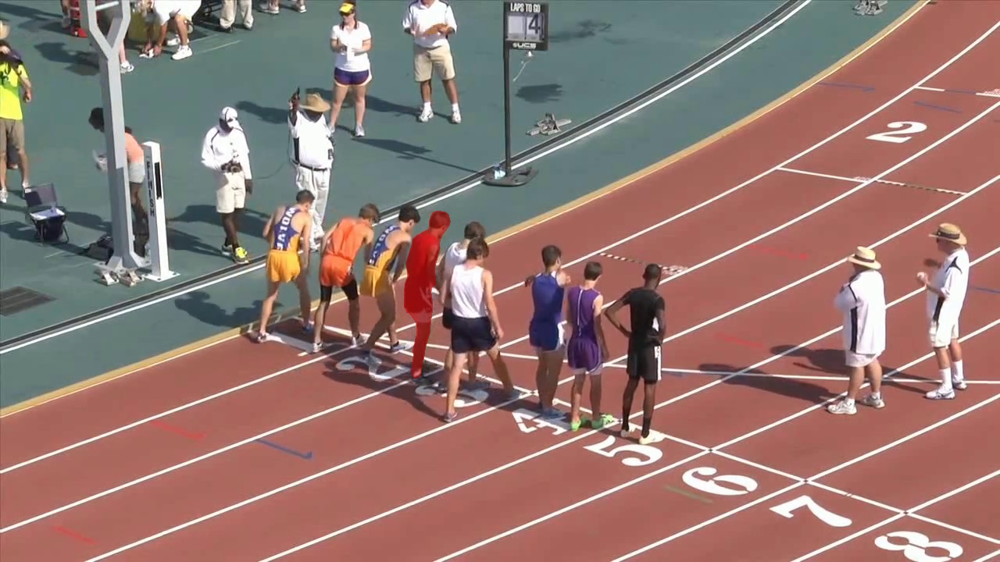

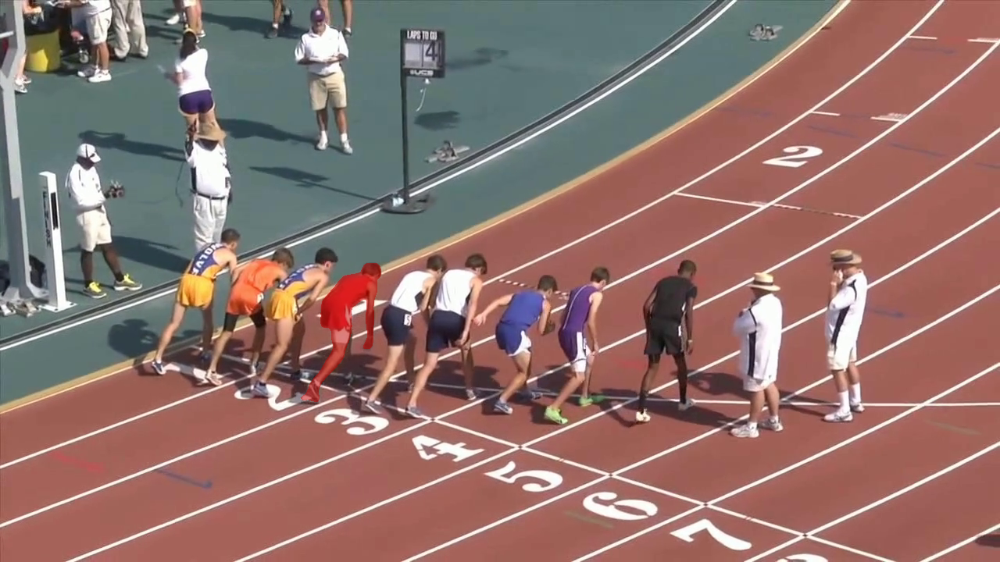

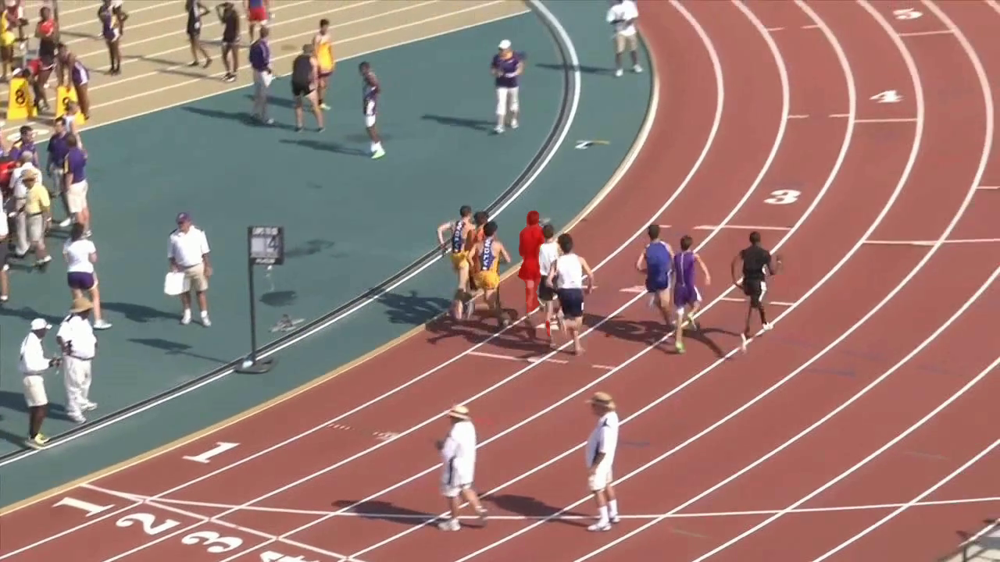

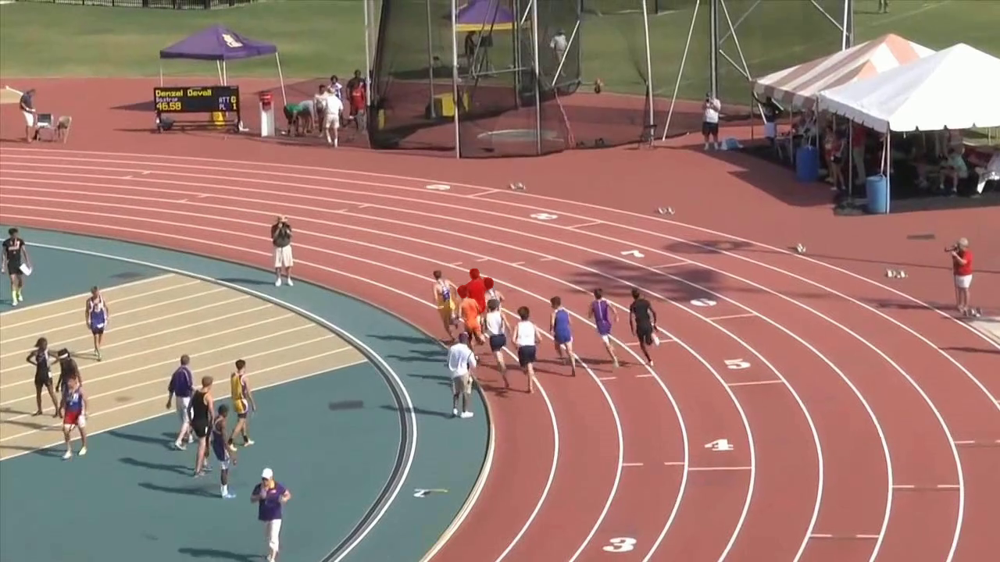

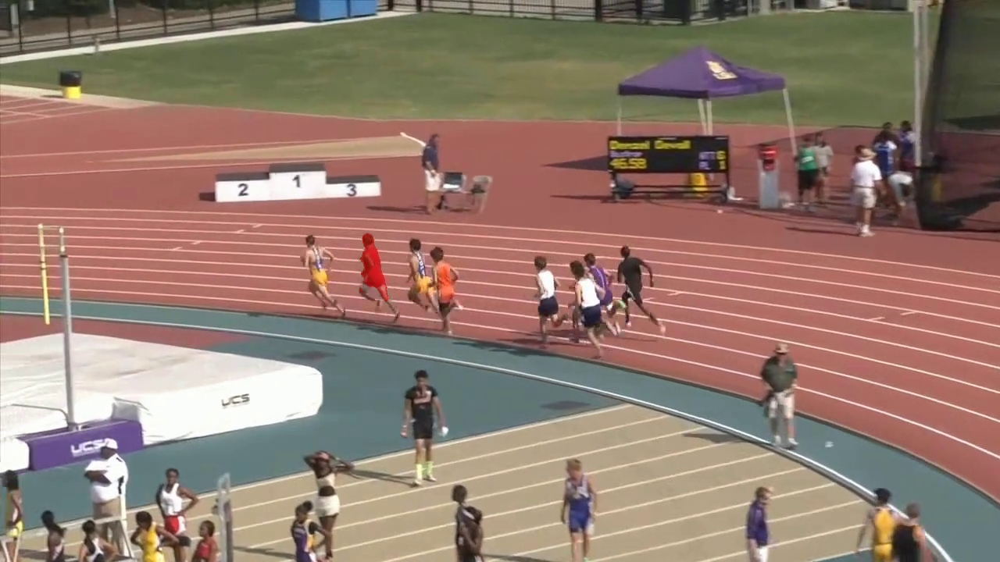

...

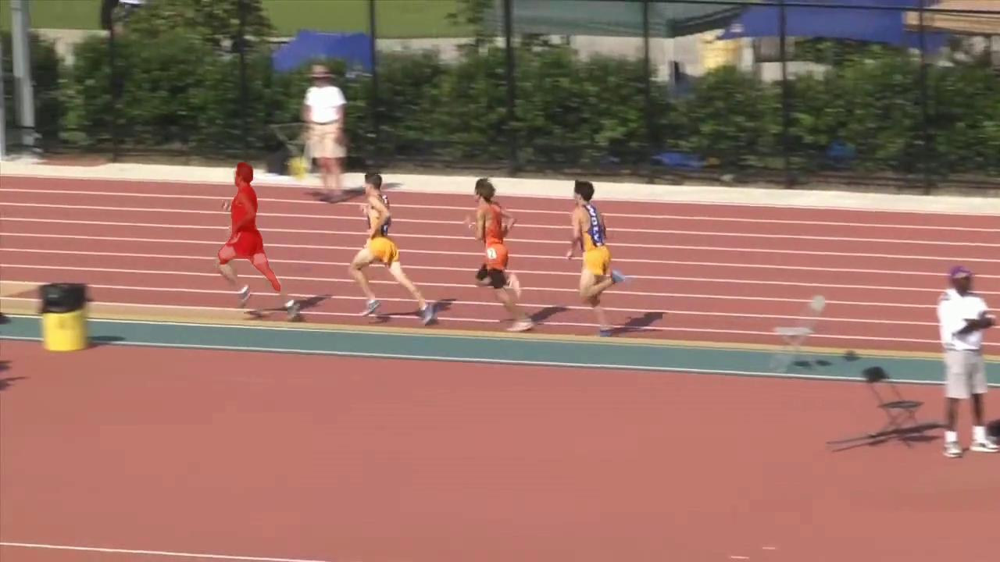

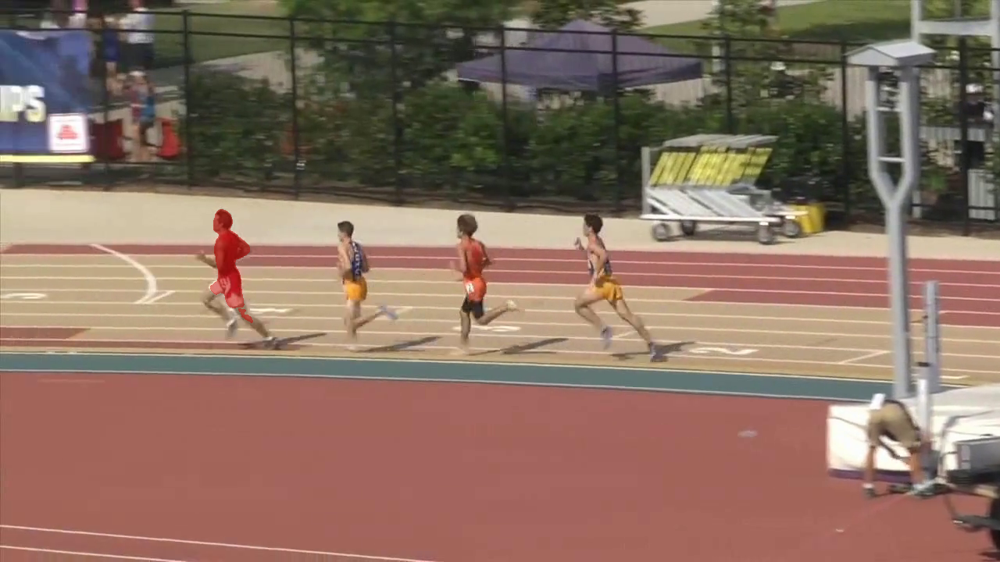

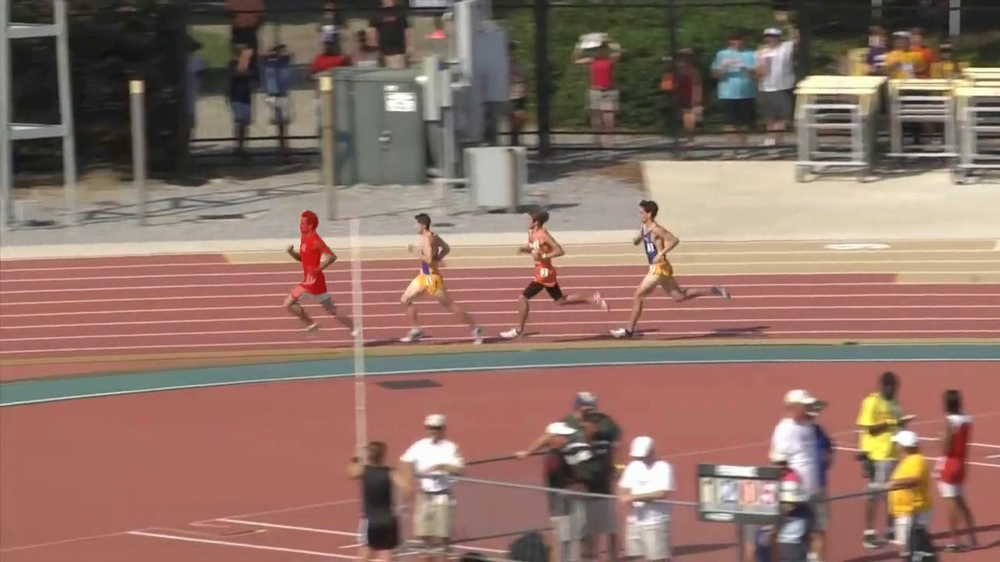

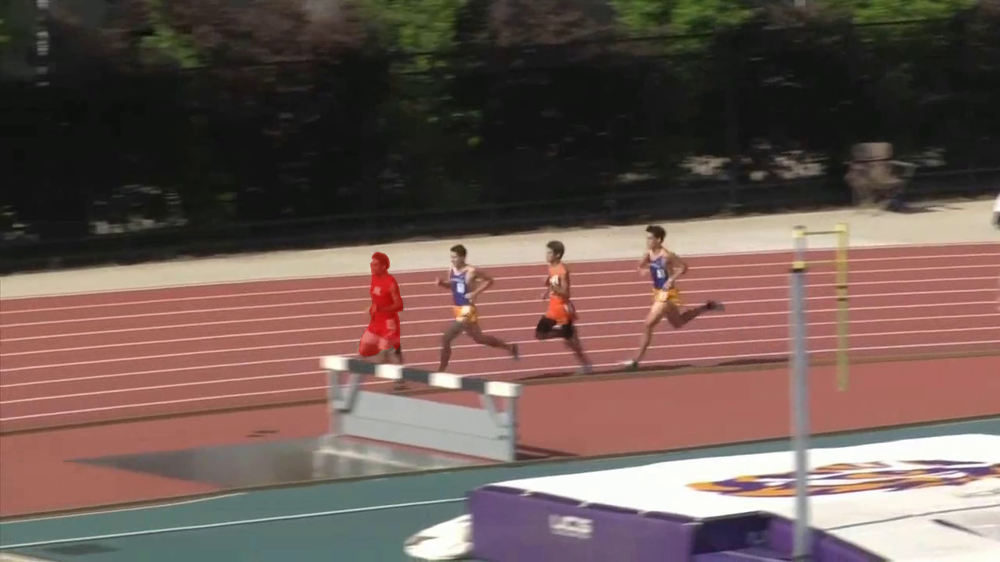

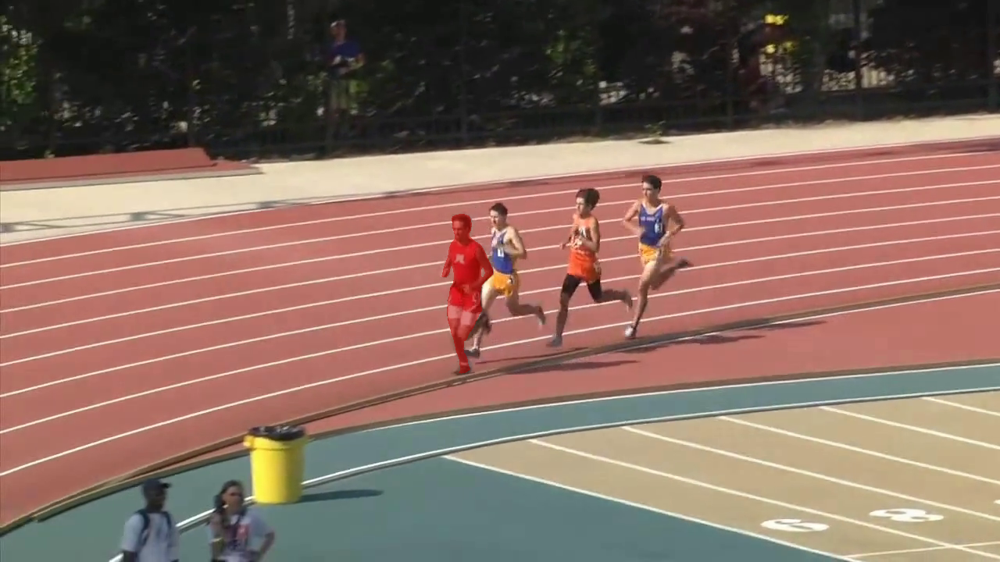

In [43]:
import cv2
import torch
from PIL import Image
from inference.interact.interactive_utils import (
    image_to_torch, index_numpy_to_one_hot_torch,
    torch_prob_to_numpy_mask, overlay_davis
)

def image_to_torch(frame: np.ndarray, device='cuda'):
    # frame: H*W*3 numpy array
    frame = frame.transpose(2, 0, 1)
    frame = torch.from_numpy(frame).float().to(device)/255
    frame_norm = im_normalization(frame)
    return frame_norm, frame

def torch_prob_to_numpy_mask(prob):
    mask = torch.max(prob, dim=0).indices
    mask = mask.cpu().numpy().astype(np.uint8)
    return mask

def index_numpy_to_one_hot_torch(mask, num_classes):
    mask = torch.from_numpy(mask).long()
    return F.one_hot(mask, num_classes=num_classes).permute(2, 0, 1).float()

def overlay_davis(image, mask, alpha=0.5, fade=False):
    """ Overlay segmentation on top of RGB image. from davis official"""
    im_overlay = image.copy()

    colored_mask = color_map_np[mask]
    foreground = image*alpha + (1-alpha)*colored_mask
    binary_mask = (mask > 0)
    # Compose image
    im_overlay[binary_mask] = foreground[binary_mask]
    if fade:
        im_overlay[~binary_mask] = im_overlay[~binary_mask] * 0.6
    return im_overlay.astype(image.dtype)


# Change working directory and clear CUDA cache
%cd '/content/'
torch.cuda.empty_cache()
num_objects = 1 #tracking one person
# Initialize the processor
processor = InferenceCore(network, config=config)
processor.set_all_labels(range(1, num_objects + 1))

# Open video file
video_path = '/content/drive/MyDrive/test_video.avi'
video_capture = cv2.VideoCapture(video_path)

# Define propagation and visualization parameters
frames_to_propagate = 3501
visualize_every = 100
frame_idx = 1
output_folder = '/content/processed_img_folder'

if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Video processing loop
while video_capture.isOpened() and frame_idx <= frames_to_propagate:
    ret, frame = video_capture.read()
    if not ret:
        break

    # Process frame
    frame_tensor = image_to_torch(frame, device=device)[0]
    if frame_idx == 1:
        initial_mask = index_numpy_to_one_hot_torch(mask, num_objects + 1).to(device)
        prediction = processor.step(frame_tensor, initial_mask[1:])
    else:
        prediction = processor.step(frame_tensor)

    # Convert prediction to numpy mask and overlay on frame
    numpy_mask = torch_prob_to_numpy_mask(prediction)
    # Convert frame from BGR to RGB after creating the mask
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    # Overlay mask on the frame
    result_frame = overlay_davis(frame, numpy_mask)
    result_image = Image.fromarray(result_frame)
    result_image.save(f"{output_folder}/frame_{frame_idx:04d}.png")

    # Display the frame at specified intervals
    if frame_idx % visualize_every == 0:
        display(result_image)

    frame_idx += 1

# Release video capture
video_capture.release()


New inference from conversion: The previous frames were generated in that way was because display libraries and frameworks such as opencv uses BGR format (Commonly used in the alignment of colour bytes in various image file formats as well within Windows).

Using BGR allowes OpenCV to interface more efficiently with these systems and images without the need for color conversion.



Code References:
    
  
   

    https://github.com/hkchengrex/XMem

    https://github.com/facebookresearch/segment-anything